In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
from sklearn.model_selection import train_test_split
import plotly.graph_objects as go
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

## Helper Functions

In [ ]:
# Helper Functions

def report(model,X_train, X_test, y_train, y_test):
    """ create score report for giving model"""
    #Fit Model
    model.fit(X_train,y_train)
    #Train Scores
    prediciton_train = model.predict(X_train)
    acc_train = accuracy_score(y_train,prediciton_train)
    p_score_train = precision_score(y_train,prediciton_train)
    r_score_train = recall_score(y_train,prediciton_train)
    f1_score_train = f1_score(y_train,prediciton_train)
    
    #Test Scores
    prediciton_test = model.predict(X_test)
    acc_test = accuracy_score(y_test,prediciton_test)
    p_score_test = precision_score(y_test,prediciton_test)
    r_score_test = recall_score(y_test,prediciton_test)
    f1_score_test = f1_score(y_test,prediciton_test)
    #create dataframe
    train_results = [acc_train,p_score_train,r_score_train,f1_score_train]
    test_results = [acc_test,p_score_test,r_score_test,f1_score_test]
    return train_results,test_results,model

def train_models(models,X_train, X_test, y_train, y_test):
    """List of models as input and prodcue a DF with the results for each model"""
    train_results =[]
    test_results=[]
    models_fit =[]
    results_df = pd.DataFrame()
    for i,model in enumerate(models):
        t_results,test_results,model_clf = report(model,X_train, X_test, y_train, y_test)
        index1= 'train'#+str(i)
        index2 = 'test'#+str(i)
        data=pd.DataFrame([t_results,test_results],columns=['Accuracy','Precission','Recall','F1_score'],index=[index1,index2])
        results_df = pd.concat([results_df,data])
        models_fit.append(model)
    results_df.reset_index(inplace=True)
    results_df=pd.melt(results_df,id_vars=['index'],value_name='score')
    results_df['index']= results_df['index'].astype('category')
    results_df['variable']= results_df['variable'].astype('category')
        
    return results_df,models_fit

def compare_models(model,xtrain,xtest):
    '''Create a dataframe with accuracy results for a set of train and test data sets'''
    results=pd.DataFrame()
    data=['Original','Norm','Std']
    for i in range(len(xtrain)):
        answ,_ = train_models([model],xtrain[i], xtest[i], y_train, y_test)
        answ['data']=data[i]
        results=pd.concat([results,answ])
    return results

def model_report(clf,xtrain,xtest):
    model_result=compare_models(clf,xtrain,xtest)
    fig=px.bar(model_result,x='variable',y='score',barmode='group',facet_col='index')
    fig.show()

## Data Gathering and preprocessing

In [ ]:
#from paper get columns:
columns =['unit_number','time_in_cycles','Altitud','Mach Number','TRA','T2','T24','T30','T50','P2','P15','P30','Nf',
           'Nc','epr','Ps30','phi','NRf','NRc','BPR','farB','htBleed','Nf_dmd','PCNfR_dmd','W31','W32','u1','u2']
dfs=[]
for num in range(1,5):
  dfs.append(pd.read_table('CMaps/train_FD00{}.txt'.format(num),sep=" ",names=columns))
test_dfs=[]
for num in range(1,5):
  test_dfs.append(pd.read_table('CMaps/test_FD00{}.txt'.format(num),sep=" ",names=columns))
# Remaining Useful Life Calculation
for i,df in enumerate(dfs):
  df['data_set']=i+1
  df['unit_number_id']=df.apply(lambda x: str(x['unit_number']) +"_"+str(i),axis=1)
  rul_df=df.groupby('unit_number')['time_in_cycles'].max().reset_index()
  rul_df.rename(columns={'time_in_cycles':'max_cycles'},inplace = True)
  dfs[i] = pd.merge(df,rul_df,on='unit_number',how='left')
  dfs[i]['target']=dfs[i]['max_cycles']-dfs[i]['time_in_cycles']
#join all data
train=pd.concat(dfs)
train.drop(columns=['u1','u2'],inplace = True)
train.loc[:,'data_set'] = train['data_set'].astype('category')
#Original Data Se
train.to_csv('nasa_data_clean.csv',index=False)

## EDA For Operational Conditions 

In [ ]:
df_f = pd.read_csv('full_training_data.csv')

In [ ]:
df_f=df_f.drop(columns=['Unnamed: 0', 'cond_unit', 'unit', 'time'])

In [ ]:
df = pd.read_csv("nasa_data_clean.csv")
df2 = df.copy()

In [ ]:
df2.columns

Index(['unit_number', 'time_in_cycles', 'Altitud', 'Mach Number', 'TRA', 'T2',
       'T24', 'T30', 'T50', 'P2', 'P15', 'P30', 'Nf', 'Nc', 'epr', 'Ps30',
       'phi', 'NRf', 'NRc', 'BPR', 'farB', 'htBleed', 'Nf_dmd', 'PCNfR_dmd',
       'W31', 'W32', 'data_set', 'unit_number_id', 'max_cycles', 'target'],
      dtype='object')

In [ ]:
df2.data_set.unique()

array([1, 2, 3, 4])

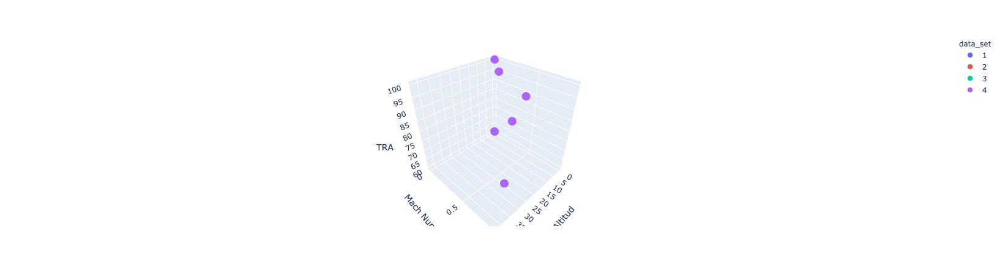

In [ ]:
df2.loc[:,'data_set'] = df2['data_set'].astype('category')
fig = px.scatter_3d(df2, x='Altitud', y='Mach Number', z='TRA',
                    color='data_set')
fig.show()

Range for the operaitonal Variables
operation 1 = a 0 mach 0 tra 100 
operation 2 = a 10 mach0.25 tra 100
operation 3 = a 25 mach0.62 tra 30
operation 4 = a 20 mach0.7 tra 100
operation 5 = a 35 mach0.84 tra 100
operation 6 = a 42 mach0.84 tra 100

### Correlation Matrix

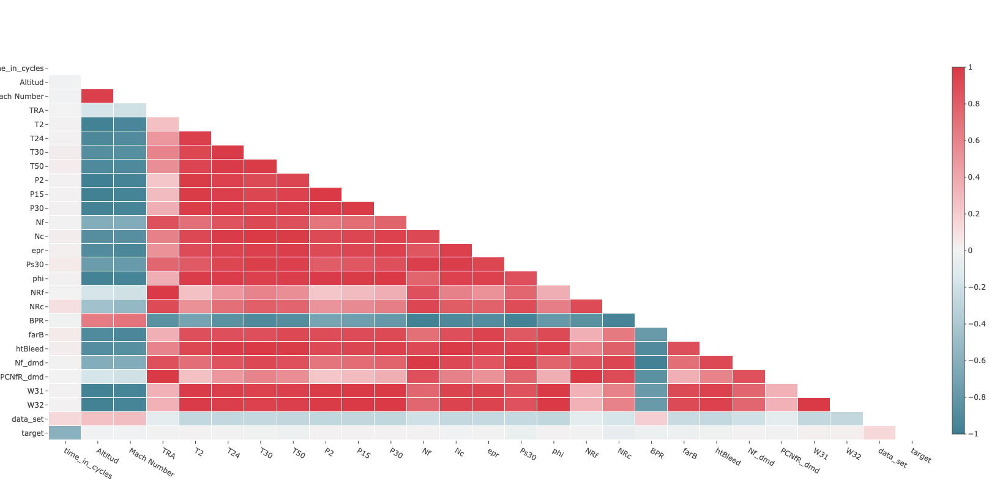

In [ ]:
import plotly.io as pio
pio.templates.default = "none"
df_corr = df.copy()
df_corr.drop(columns=['max_cycles','unit_number','unit_number_id'],inplace = True)

corr = df_corr.corr()

mask = np.zeros_like(corr, dtype = np.bool) #probably could do this on df… to check
mask[np.triu_indices_from(mask)] = True
corr1=corr.mask(mask)

X = corr1.columns.values
sns_colorscale = [[0.0, '#3f7f93'],
                    [0.071, '#5890a1'],
                    [0.143, '#72a1b0'],
                    [0.214, '#8cb3bf'],
                    [0.286, '#a7c5cf'],
                    [0.357, '#c0d6dd'],
                    [0.429, '#dae8ec'],
                    [0.5, '#f2f2f2'],
                    [0.571, '#f7d7d9'],
                    [0.643, '#f2bcc0'],
                    [0.714, '#eda3a9'],
                    [0.786, '#e8888f'],
                    [0.857, '#e36e76'],
                    [0.929, '#de535e'],
                    [1.0, '#d93a46']]
heat = go.Heatmap(z=corr1,
                    x=X, #check direct df column use
                    y=X, #check direct df row/index use
                    xgap=1, ygap=1,
                    colorscale=sns_colorscale, #“Magma”
                    colorbar_thickness=20,
                    colorbar_ticklen=3,
                    zmid=0, #added

#hovertext ='hovertext'
                       )
title = ""

layout = go.Layout(title_text=title, title_x=0.5,
                    width=800, height=800,
                    xaxis_showgrid=False,
                    yaxis_showgrid=False,
                    yaxis_autorange='reversed')

corr_fig=go.Figure(data=[heat], layout=layout)
corr_fig.show()

The data contains highly correlate features which might contribute to overfiting. That's why the feature selection would be important part of the QuAm develpment

## Feature Selection and Engineering 

In [ ]:
# Create the operation condition feature
df['o_condition']=0
condition1 = df['Altitud'] < 2
condition2 = (df['Altitud'] < 12) & (df['Altitud'] >2)
condition3 = (df['Altitud'] < 22) & (df['Altitud'] >12)
condition4 = (df['Altitud'] < 27) & (df['Altitud'] >22)
condition5 = (df['Altitud'] < 37) & (df['Altitud'] >27)
condition6 = (df['Altitud'] < 44) & (df['Altitud'] >37)
df.loc[condition1,'o_condition']=1
df.loc[condition2,'o_condition']=2
df.loc[condition3,'o_condition']=3
df.loc[condition4,'o_condition']=4
df.loc[condition5,'o_condition']=5
df.loc[condition6,'o_condition']=6

In [ ]:
# Creating the calisificaiton target
target = 25
label_positive =df['target'] <= target 
df['label_target']=0
df.loc[label_positive,'label_target'] = 1

In [ ]:
df.columns

Index(['unit_number', 'time_in_cycles', 'Altitud', 'Mach Number', 'TRA', 'T2',
       'T24', 'T30', 'T50', 'P2', 'P15', 'P30', 'Nf', 'Nc', 'epr', 'Ps30',
       'phi', 'NRf', 'NRc', 'BPR', 'farB', 'htBleed', 'Nf_dmd', 'PCNfR_dmd',
       'W31', 'W32', 'data_set', 'unit_number_id', 'max_cycles', 'target',
       'o_condition', 'label_target'],
      dtype='object')

## Base Models (Decission Tree)

### Base Model with Original Data

In [ ]:
base_model = DecisionTreeClassifier()
y=df['label_target'].values
X_base =df.drop(columns=['label_target','unit_number_id','max_cycles','data_set','target','unit_number']).values
X_train, X_test, y_train, y_test = train_test_split( X_base, y, test_size=0.33, random_state=42,stratify=y)
base_model_results,base_model_fit=train_models([base_model],X_train, X_test, y_train, y_test)


In [ ]:
base_model_results

,index,variable,score
0,train,Accuracy,1.000000
1,test,Accuracy,0.953306
2,train,Precission,1.000000
3,test,Precission,0.797921
4,train,Recall,1.000000
5,test,Recall,0.795167
6,train,F1_score,1.000000
7,test,F1_score,0.796542


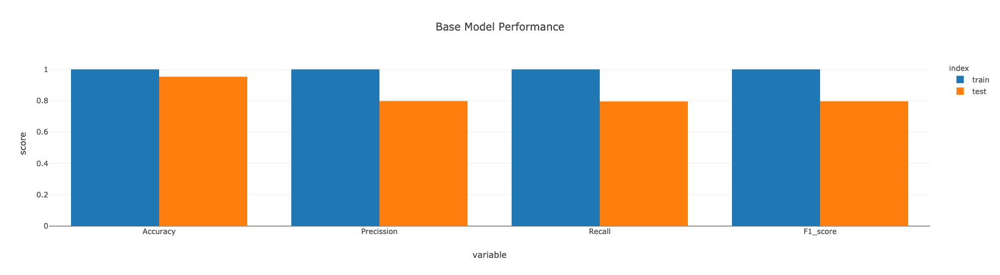

In [ ]:
fig=px.bar(base_model_results,x='variable',y='score',barmode='group',color='index',title='Base Model Performance')
fig.show()

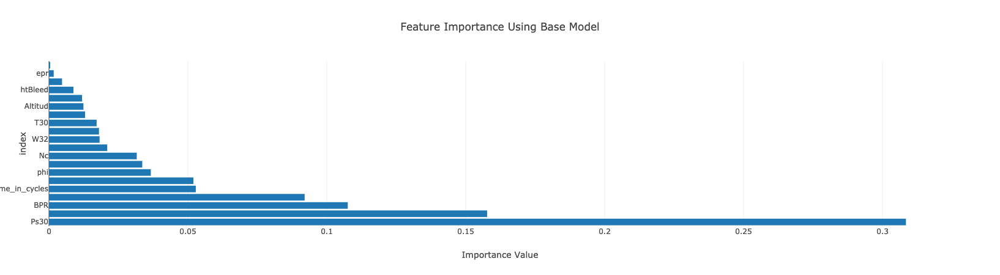

In [ ]:
columns_names=df.drop(columns=['label_target','unit_number_id','max_cycles','data_set','target','unit_number']).columns
df_f= pd.DataFrame(base_model_fit[0].feature_importances_,index=columns_names,columns=['Importance Value'])
df_f= df_f.sort_values(by='Importance Value',ascending=False)
px.bar(df_f[:20],x='Importance Value', title='Feature Importance Using Base Model')

### Feature Selection Based on Feature Importance 

In [ ]:
#Selecting the best 10 columns
df_f.T.columns[:8]

Index(['Ps30', 'NRf', 'BPR', 'T50', 'time_in_cycles', 'NRc', 'phi', 'P30'], dtype='object')

In [ ]:
# Use most importante features
df_train=df[['Ps30', 'NRf', 'BPR', 'T50', 'time_in_cycles', 'NRc', 'phi', 'P30','Nc', 'Nf','o_condition','label_target']]

In [ ]:
base_model_2 = DecisionTreeClassifier()
y=df_train['label_target'].values
X_base_2 =df_train.drop(columns=['label_target']).values
X_train, X_test, y_train, y_test = train_test_split( X_base_2, y, test_size=0.33, random_state=42,stratify=y)
base_model_results2,base_model_fit2=train_models([base_model_2],X_train, X_test, y_train, y_test)

In [ ]:
base_model_results2

,index,variable,score
0,train,Accuracy,1.000000
1,test,Accuracy,0.952210
2,train,Precission,1.000000
3,test,Precission,0.792944
4,train,Recall,1.000000
5,test,Recall,0.790728
6,train,F1_score,1.000000
7,test,F1_score,0.791835


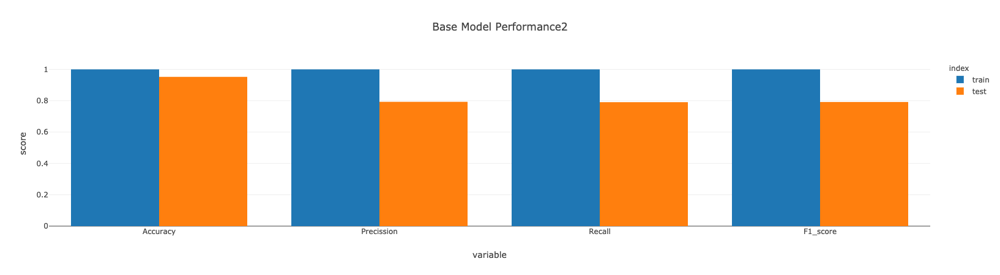

In [ ]:
fig=px.bar(base_model_results2,x='variable',y='score',barmode='group',color='index',title='Base Model Performance2')
fig.show()

Similar performance as model with all features. 

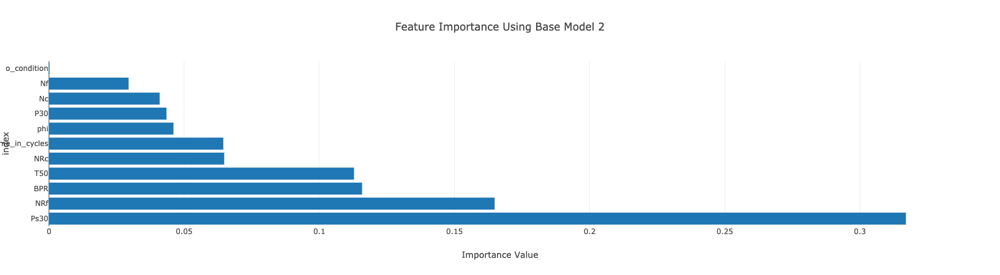

In [ ]:
columns_names=df[['Ps30', 'NRf', 'BPR', 'T50', 'time_in_cycles', 'NRc', 'phi', 'P30','Nc', 'Nf','o_condition']].columns
df_f2= pd.DataFrame(base_model_fit2[0].feature_importances_,index=columns_names,columns=['Importance Value'])
df_f2= df_f2.sort_values(by='Importance Value',ascending=False)
px.bar(df_f2,x='Importance Value', title='Feature Importance Using Base Model 2')

### Create New Features using Rolling std, Rolling Mean, Rolling Media (Feature Enginering Model)

In [ ]:
y=df_train['label_target'].values
X =df_train.drop(columns=['label_target','o_condition'])
for col in X.columns:
    col_name = col+'r_std'
    X[col_name]=X[col].rolling(10).std()
    col_name2= col+'r_mean'
    X[col_name2]=X[col].rolling(10).mean()
    col_name3 = col+'r_median'
    X[col_name3]=X[col].rolling(10).median()
    col_name4 = col+'r_min'
    X[col_name4]=X[col].rolling(10).min()
    col_name5 = col+'r_max'
    X[col_name5]=X[col].rolling(10).max()
    

In [ ]:
X= X.fillna(0)

In [ ]:
X.columns

Index(['Ps30', 'NRf', 'BPR', 'T50', 'time_in_cycles', 'NRc', 'phi', 'P30',
       'Nc', 'Nf', 'Ps30r_std', 'Ps30r_mean', 'Ps30r_median', 'Ps30r_min',
       'Ps30r_max', 'NRfr_std', 'NRfr_mean', 'NRfr_median', 'NRfr_min',
       'NRfr_max', 'BPRr_std', 'BPRr_mean', 'BPRr_median', 'BPRr_min',
       'BPRr_max', 'T50r_std', 'T50r_mean', 'T50r_median', 'T50r_min',
       'T50r_max', 'time_in_cyclesr_std', 'time_in_cyclesr_mean',
       'time_in_cyclesr_median', 'time_in_cyclesr_min', 'time_in_cyclesr_max',
       'NRcr_std', 'NRcr_mean', 'NRcr_median', 'NRcr_min', 'NRcr_max',
       'phir_std', 'phir_mean', 'phir_median', 'phir_min', 'phir_max',
       'P30r_std', 'P30r_mean', 'P30r_median', 'P30r_min', 'P30r_max',
       'Ncr_std', 'Ncr_mean', 'Ncr_median', 'Ncr_min', 'Ncr_max', 'Nfr_std',
       'Nfr_mean', 'Nfr_median', 'Nfr_min', 'Nfr_max'],
      dtype='object')

In [ ]:
X['o_condition']=df['o_condition']
#drop raw sensor data 
X=X.drop(columns=['Ps30', 'NRf', 'BPR', 'T50', 'time_in_cycles', 'NRc', 'phi', 'P30','Nc', 'Nf'])
# Using Oveersampling

In [ ]:
feature_eng1 = DecisionTreeClassifier()
#X =X.values
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.33, random_state=42,stratify=y)
feature_eng1,f_eng1=train_models([feature_eng1],X_train, X_test, y_train, y_test)

In [ ]:
feature_eng1

,index,variable,score
0,train,Accuracy,1.000000
1,test,Accuracy,0.979365
2,train,Precission,1.000000
3,test,Precission,0.912411
4,train,Recall,1.000000
5,test,Recall,0.907611
6,train,F1_score,1.000000
7,test,F1_score,0.910005


In [ ]:
X.columns

Index(['Ps30r_std', 'Ps30r_mean', 'Ps30r_median', 'Ps30r_min', 'Ps30r_max',
       'NRfr_std', 'NRfr_mean', 'NRfr_median', 'NRfr_min', 'NRfr_max',
       'BPRr_std', 'BPRr_mean', 'BPRr_median', 'BPRr_min', 'BPRr_max',
       'T50r_std', 'T50r_mean', 'T50r_median', 'T50r_min', 'T50r_max',
       'time_in_cyclesr_std', 'time_in_cyclesr_mean', 'time_in_cyclesr_median',
       'time_in_cyclesr_min', 'time_in_cyclesr_max', 'NRcr_std', 'NRcr_mean',
       'NRcr_median', 'NRcr_min', 'NRcr_max', 'phir_std', 'phir_mean',
       'phir_median', 'phir_min', 'phir_max', 'P30r_std', 'P30r_mean',
       'P30r_median', 'P30r_min', 'P30r_max', 'Ncr_std', 'Ncr_mean',
       'Ncr_median', 'Ncr_min', 'Ncr_max', 'Nfr_std', 'Nfr_mean', 'Nfr_median',
       'Nfr_min', 'Nfr_max', 'o_condition'],
      dtype='object')

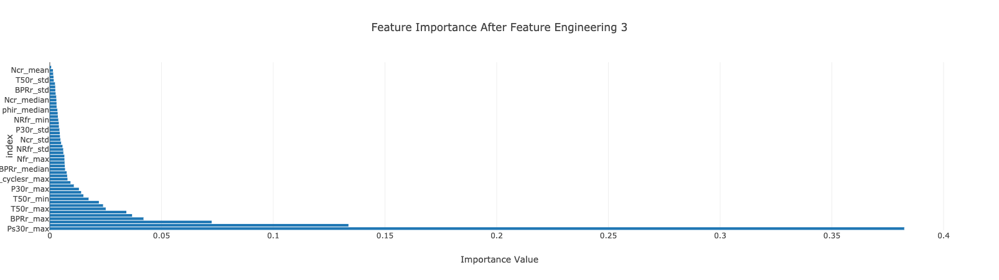

In [ ]:
columns_names=X.columns
df_f3= pd.DataFrame(f_eng1[0].feature_importances_,index=columns_names,columns=['Importance Value'])
df_f3= df_f3.sort_values(by='Importance Value',ascending=False)
px.bar(df_f3,x='Importance Value', title='Feature Importance After Feature Engineering 3')

Performance improve slightly that from base model

###   (Feature Enginering Model (Raihan Data file))

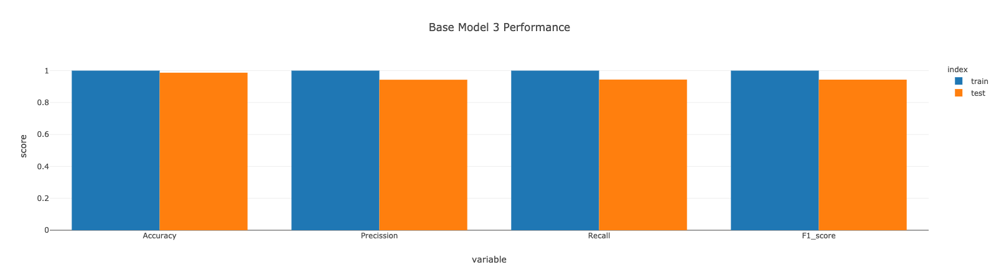

In [ ]:
base_model = DecisionTreeClassifier()
y=df['label_target'].values
X_base3 =df_f.drop(columns=['RUL']).values
X_train, X_test, y_train, y_test = train_test_split( X_base3, y, test_size=0.33, random_state=42,stratify=y)
base_model_results3,base_model_fit3=train_models([base_model],X_train, X_test, y_train, y_test)
fig=px.bar(base_model_results3,x='variable',y='score',barmode='group',color='index',title='Base Model 3 Performance')
fig.show()

In [ ]:
base_model_results3

,index,variable,score
0,train,Accuracy,1.000000
1,test,Accuracy,0.986999
2,train,Precission,1.000000
3,test,Precission,0.943012
4,train,Recall,1.000000
5,test,Recall,0.943942
6,train,F1_score,1.000000
7,test,F1_score,0.943477


### Vizualization Transformation

In [ ]:
X_viz =df.drop(columns=['label_target','o_condition'])
for col in X_viz.columns:
    col_name = col+'r_std'
    X_viz[col_name]=X_viz[col].rolling(10).std()
    col_name2= col+'r_mean'
    X_viz[col_name2]=X_viz[col].rolling(10).mean()
    col_name3 = col+'r_median'
    X_viz[col_name3]=X_viz[col].rolling(10).median()
    col_name4 = col+'r_min'
    X_viz[col_name4]=X_viz[col].rolling(10).min()
    col_name5 = col+'r_max'
    X_viz[col_name5]=X_viz[col].rolling(10).max()


In [ ]:
import matplotlib.pyplot as plt
def plot_metrics(condition_unit, metric):
    plotdata=X_viz[X_viz['unit_number_id']==condition_unit]
    plotdata=plotdata.iloc[10:,:]
    plt.figure(figsize=(20,10))
    plt.title(condition_unit+' '+ metric)
    plt.plot('time_in_cycles', metric, data=plotdata, marker='', markerfacecolor='blue', markersize=12, color='skyblue', linewidth=4)
    
    plt.plot('time_in_cycles', metric+'r_min', data=plotdata, marker='', color='green', linewidth=2)
    plt.plot('time_in_cycles', metric+'r_max', data=plotdata, marker='', color='red', linewidth=2)
    plt.plot('time_in_cycles', metric+'r_mean', data=plotdata, marker='', color='violet', linewidth=2)
    plt.plot('time_in_cycles', metric+'r_median', data=plotdata, marker='', color='orange', linewidth=2)
    plt.ylabel("sensor values",color="black",fontsize=14)
    plt.legend()
    ax2=plt.twinx() 
    #make a plot with different y-axis using second axis object
    ax2.plot('time_in_cycles', metric+'r_std', data=plotdata, marker='', color='purple', linewidth=2)
    ax2.set_ylabel("standard deviation",color="purple",fontsize=14)
    ax2.legend()

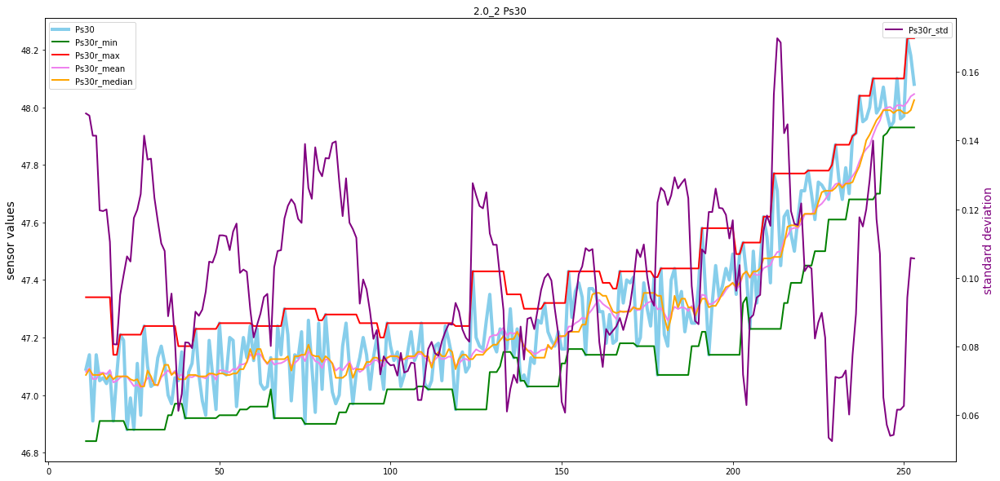

In [ ]:
plot_metrics('2.0_2','Ps30')

### Oversampling Model (Feature engineering + Oversampling)

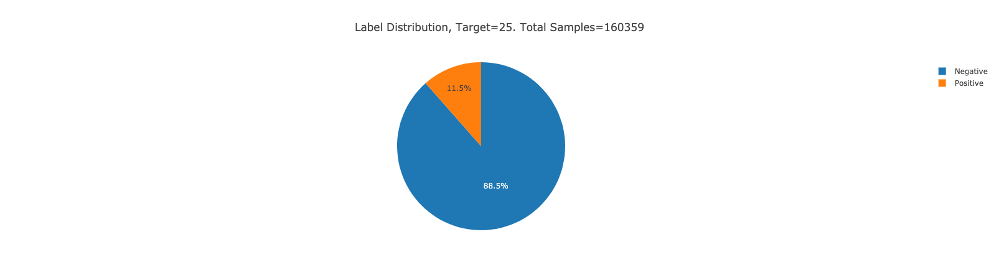

In [ ]:
positive_labels=df['label_target'].sum()
p_positive_labels= positive_labels/len(df)*100
p_negatives_labels = 100-p_positive_labels
negative_labels = len(df)-positive_labels
label_distribution=pd.DataFrame([[p_positive_labels,p_negatives_labels]],columns=['Positive','Negative'],index=['Percent'])
label_distribution= label_distribution.T.reset_index()
fig= px.pie(label_distribution, values='Percent',names='index',title='Label Distribution, Target={}. Total Samples={}'.format(target,len(df)))
fig.show()

In [ ]:
os = SMOTE()
X , y = os.fit_resample(X,y)

In [ ]:
X.shape,y.shape

((283850, 51), (283850,))

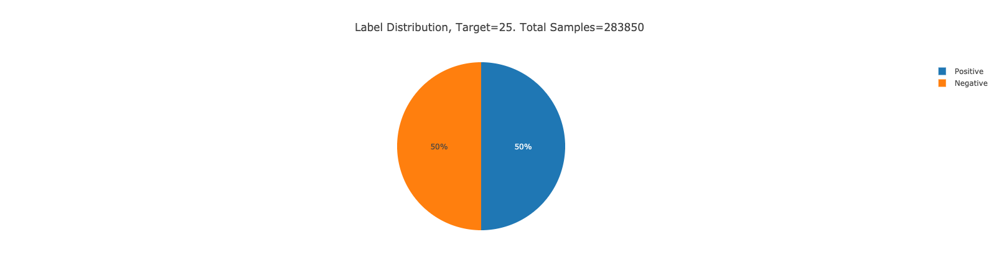

In [ ]:
positive_labels=y.sum()
p_positive_labels2= positive_labels/len(y)*100
p_negatives_labels2 = 100-p_positive_labels2
negative_labels2 = len(y)-positive_labels
label_distribution2=pd.DataFrame([[p_positive_labels2,p_negatives_labels2]],columns=['Positive','Negative'],index=['Percent'])
label_distribution2= label_distribution2.T.reset_index()
fig2= px.pie(label_distribution2, values='Percent',names='index',title='Label Distribution, Target={}. Total Samples={}'.format(target,len(y)))
fig2.show()

In [ ]:
y.sum()/len(y)

0.5

In [ ]:
X['label_target']=y

In [ ]:
X.to_csv('nasa_data_final.csv',index=False)

In [ ]:
X=X.drop(columns=['label_target'])

In [ ]:
feature_eng2 = DecisionTreeClassifier()
X_train, X_test, y_train, y_test = train_test_split( X.values, y, test_size=0.33, random_state=42,stratify=y)

In [ ]:
feature_eng2,f_eng2=train_models([feature_eng2],X_train, X_test, y_train, y_test)
feature_eng2

,index,variable,score
0,train,Accuracy,1.000000
1,test,Accuracy,0.984627
2,train,Precission,1.000000
3,test,Precission,0.983368
4,train,Recall,1.000000
5,test,Recall,0.985929
6,train,F1_score,1.000000
7,test,F1_score,0.984647


Best Results after Oversampling

## Compare Results

In [ ]:
feature_eng2['model']='Feature_eng+Oversampling'
feature_eng1['model']= 'Feature_eng'
base_model_results2['model']= 'Feature_selection'
base_model_results['model']= 'Original Data'
base_model_results3['model']= 'Feature_eng2'
results_feature_eng=pd.concat([base_model_results,base_model_results2,feature_eng1,base_model_results3,feature_eng2])

In [ ]:
results_feature_eng

,index,variable,score,model
0,train,Accuracy,1.000000,Original Data
1,test,Accuracy,0.953306,Original Data
2,train,Precission,1.000000,Original Data
3,test,Precission,0.797921,Original Data
4,train,Recall,1.000000,Original Data
5,test,Recall,0.795167,Original Data
6,train,F1_score,1.000000,Original Data
7,test,F1_score,0.796542,Original Data
0,train,Accuracy,1.000000,Feature_selection
1,test,Accuracy,0.952210,Feature_selection


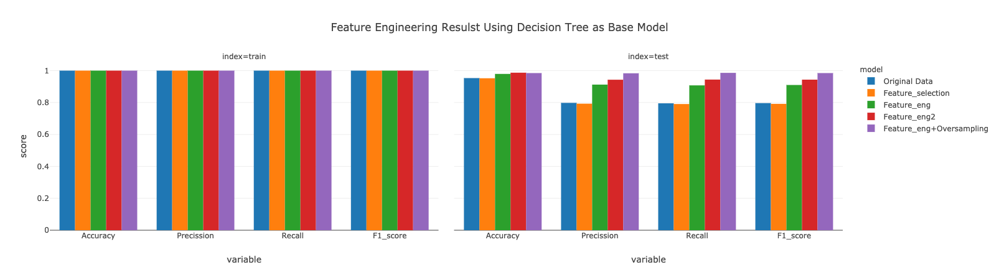

In [ ]:
fig=px.bar(results_feature_eng,x='variable',y='score',color='model',barmode='group',facet_col='index',title='Feature Engineering Resulst Using Decision Tree as Base Model')
fig.show()

## Processing For kNN and Linear Regression

In [ ]:

from sklearn.preprocessing import StandardScaler
ss_std = StandardScaler().fit(X_train)
from sklearn.preprocessing import MinMaxScaler
MinMax_norm = MinMaxScaler().fit(X_train)
#train data transformation
X_train_std = ss_std.transform(X_train) 
#df_stnd = pd.DataFrame(X_train_std,columns=col_names)
X_train_norm = MinMax_norm.transform(X_train) 
#df_norm=pd.DataFrame(X_train_norm,columns=col_names)
#Test data transformation
X_test_norm =MinMax_norm.transform(X_test) 
X_test_std =ss_std.transform(X_test)
# xtrain=[X_train,X_train_norm,X_train_std]
# xtest=[X_test,X_test_norm,X_test_std]
xtrain=[X_train_norm]
xtest=[X_test_norm]


### Comparing DT and KNN base models, using Normalize data

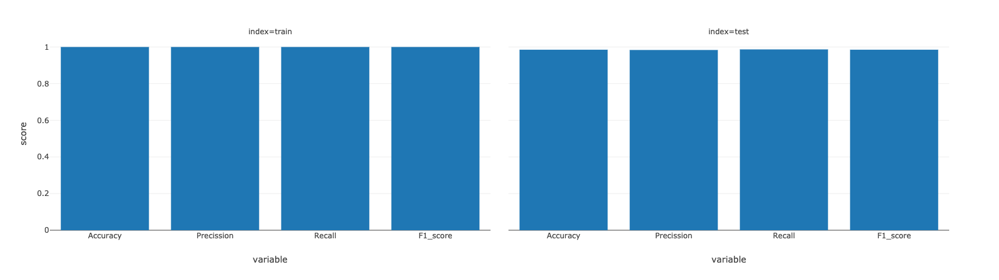

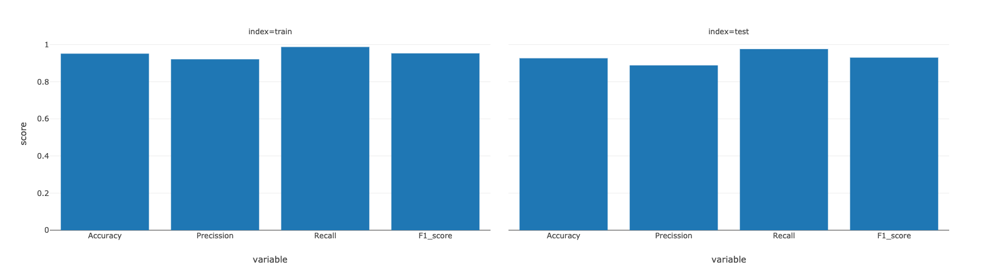

In [ ]:
tree_clf=DecisionTreeClassifier()
knn_clf = KNeighborsClassifier()
for model in [tree_clf,knn_clf]:
    model_report(model,xtrain,xtest)